-----------------------------
# 2023 MIMIC-II SOPData Exploratory Data Analysis (EDA)  
-----------------------------

###  Perform Exploratory Data Analysis (EDA) to identify the impact of various attributes on blood pressure monitoring

Data set is the SOP (featured) Data generated from 2023 MIMIC-II data

--------------------------
### Attribute/feature Information:

**Note 1**: *"Attirbute" and "feture" are used interchangablly in this notebook*

**Note 2**: Attributes description names or term acronyms:
- *BP* -- Blood Pressure
- *SBP* -- Systolic Blood Pressure
- *DBP* -- Diastolic Blood Pressure
- *STAT* -- Superficial Temporal Artery Tonometry, which is a method/system to measure BP
- *SQI* -- Signal Quality Index, 0~100, the higher the better signal quality
- *ECG* -- Electrocardiography, which records the electrical signals in a heart
- *HR* -- Heart Rate
- *PTT* -- Pulse Transit Time, i.e., the time delay for the pressure wave to travel between two arterial sites. PTT is often inversely related to BP.
- *Finapres* -- The Finapres® NOVA is an innovative hemodynamic monitoring system. It provides accurate non-invasive continuous blood pressure monitoring using just a finger cuff. It is the golden standard blood pressure measurement system in our dataset. See https://www.finapres.com/
- *The 'interp' in attributes names represents: "interpreted to have the same length as that of the other attributes"*
- *The 'cal' in attributes names represents: "calibrated with the beginning signal of Finapres/ground_truth (DBP or SBP) blood presssure"

--------------------------

**HRinterp**: a numeric vector, Heart Rate, heart beats per minute, here/this_data_set estimated from ECG 

**PTTsbpinterp1**: a numeric vector, SBP estimated from PTT algorithm 1

**PTTdbpinterp1**:a numeric vector,  DBP estimated from PTT algorithm 1

**PTTsbpinterp2**: a numeric vector, SBP estimated from PTT algorithm 2

**PTTdbpinterp2**: a numeric vector, DBP estimated from PTT algorithm 2

**PTTsbpinterp3**: a numeric vector, SBP estimated from PTT algorithm 3

**PTTdbpinterp3**: a numeric vector, DBP estimated from PTT algorithm 3

**PTTsbpinterp4**: a numeric vector, SBP estimated from PTT algorithm 4

**PTTdbpinterp4**: a numeric vector, DBP estimated from PTT algorithm 4

**PTTinterp**: a numeric vector, PTT estimated blood pressure 

**SQI**: a numeric vector, ECG SQI

**FinsbpSec**: a numeric vector, FinsbpSec, SBP estimated from Finapres (measured BP), which is the ground truth SBP in our dataset

**FindbpSec**: a numeric vector, FindbpSec, DBP estimated Finapres (measured BP), which is the ground truth DBP in our dataset


# Table of Contents
------------------------
- 1. <a href = #link1> Import Libraries</a>
- 2. <a href = #link2> Load the data</a>
- 3. <a href = #link3> Overview of the data </a>
- 4. <a href = #link4> Univariate Analysis</a>
- 5. <a href = #link5> Bivariate Analysis</a>
- 6. <a href = #link6> Calculate PhiK (𝜙k) correlation coefficents</a>
- 7. <a href = #link7> Pandas Profiling</a> 
- 8. <a href = #link8> Export this notebook to a html file</a>

------------------------

## Reset all variables

In [3]:
# Reset all variables, -f force action without prompting yes/no
%reset -f 

# <a id= 'link1'>Import the libraries</a>

In [4]:
import warnings
warnings.filterwarnings('ignore')   # to avoid warnings

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp
import math
from scipy import io
sns.set(style="darkgrid")

# <a id='link2'> Load the data </a>

### Load in the dataset, combine and convert X and Y data into a dataframe

In [5]:
# Load in the .mat file
import os
import pathlib

################
# NOTE: Change the directory and file index below for the directory and file you would like to analyze
cwd = os.getcwd() # get the current directory
matfile_dir = cwd + "\\sopData\\" # NOTE: TODO: change this as your to be analyzed .mat files' directory

cwd

'/kaggle/working'

In [6]:
# load in this .mat file
# File paths
file_paths = [
    "/kaggle/input/fixed-part-1-10/mimic_features_part_1_numCells_ 1000 .mat",
        "/kaggle/input/fixed-part-1-10/mimic_features_part_2_numCells_ 1000 .mat",
        "/kaggle/input/fixed-part-1-10/mimic_features_part_3_numCells_ 1000 .mat",
        "/kaggle/input/fixed-part-1-10/mimic_features_part_4_numCells_ 1000 .mat",
        "/kaggle/input/fixed-part-1-10/mimic_features_part_5_numCells_ 1000 .mat",
        "/kaggle/input/fixed-part-1-10/mimic_features_part_6_numCells_ 1000 .mat",
        "/kaggle/input/fixed-part-1-10/mimic_features_part_7_numCells_ 1000 .mat",
        "/kaggle/input/fixed-part-1-10/mimic_features_part_8_numCells_ 1000 .mat",
        "/kaggle/input/fixed-part-1-10/mimic_features_part_9_numCells_ 1000 .mat",
        "/kaggle/input/fixed-part-1-10/mimic_features_part_10_numCells_ 1000 .mat",
]

# Initialize empty lists
Xdata_list = []
Ydata_list = []
IDdata_list = []

# Iterate over file paths
for file_path in file_paths:
    # Load the MATLAB file
    part = sp.io.loadmat(file_path)
    
    # Extract Xdata, Ydata, and IDdata
    Xdata_list.append(pd.DataFrame(part['Xdata']))
    Ydata_list.append(pd.DataFrame(part['Ydata']))
    IDdata_list.append(pd.DataFrame(part['IDdata'], columns=['ID']))


# Concatenate the lists of DataFrames
Xdata = pd.concat(Xdata_list, axis=0, ignore_index=True)
Ydata = pd.concat(Ydata_list, axis=0, ignore_index=True)
IDdata = pd.concat(IDdata_list, axis=0, ignore_index=True)

Xdata.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
0,119.047619,115.876678,66.037212,117.384305,66.687493,115.888039,61.981542,113.268436,63.428866,0.200000,-0.012906,-0.060606,99.666667,98.0,100.0
1,122.950820,115.874233,66.034257,117.382456,66.685100,115.887698,61.981202,113.267940,63.428633,0.203016,-0.010959,-0.140274,99.000000,98.0,100.0
2,120.967742,115.721724,65.819812,117.265945,66.521059,115.888212,61.981715,113.268690,63.428985,0.208000,-0.001114,-0.015152,99.469945,98.0,100.0
3,123.891427,113.315516,65.181112,115.480257,66.302121,116.043986,62.137489,113.495672,63.535982,0.208000,-0.006619,0.009775,100.000000,98.0,100.0
4,124.025800,111.465090,64.809064,114.329128,66.299237,111.039341,57.132844,106.205050,60.098582,0.216000,0.011584,0.124633,99.519126,98.0,100.0


In [7]:
Xdata.shape

(1767512, 15)

In [8]:
# Get Xdata dataframe with added feature/column names
Xdata.columns = ['HRinterp', 'PTTsbpinterp1', 'PTTdbpinterp1', 'PTTsbpinterp2', 'PTTdbpinterp2',
                 'PTTsbpinterp3', 'PTTdbpinterp3', 'PTTsbpinterp4', 'PTTdbpinterp4',
                 'PTTinterp', 'NIRSOpticalData', 'ECG', 'NIRS_SQIinterp', 'ECG_SQIinterp', 'FIN-SQIinterp']

Ydata.columns = ['FinsbpSec', 'FindbpSec']

IDdata.columns = ['ID']

# Concante them into one dataframe for analysis conveninece
df = pd.concat([Xdata, Ydata], axis="columns")
df_with_id = pd.concat([Xdata, Ydata, IDdata], axis="columns")

df_with_id.head()

,HRinterp,PTTsbpinterp1,PTTdbpinterp1,PTTsbpinterp2,PTTdbpinterp2,PTTsbpinterp3,PTTdbpinterp3,PTTsbpinterp4,PTTdbpinterp4,PTTinterp,NIRSOpticalData,ECG,NIRS_SQIinterp,ECG_SQIinterp,FIN-SQIinterp,FinsbpSec,FindbpSec,ID
0,119.047619,115.876678,66.037212,117.384305,66.687493,115.888039,61.981542,113.268436,63.428866,0.200000,-0.012906,-0.060606,99.666667,98.0,100.0,119.727364,66.225288,[part_1_cell_1]
1,122.950820,115.874233,66.034257,117.382456,66.685100,115.887698,61.981202,113.267940,63.428633,0.203016,-0.010959,-0.140274,99.000000,98.0,100.0,120.280742,66.517372,[part_1_cell_1]
2,120.967742,115.721724,65.819812,117.265945,66.521059,115.888212,61.981715,113.268690,63.428985,0.208000,-0.001114,-0.015152,99.469945,98.0,100.0,120.889700,66.845192,[part_1_cell_1]
3,123.891427,113.315516,65.181112,115.480257,66.302121,116.043986,62.137489,113.495672,63.535982,0.208000,-0.006619,0.009775,100.000000,98.0,100.0,121.531630,67.196587,[part_1_cell_1]
4,124.025800,111.465090,64.809064,114.329128,66.299237,111.039341,57.132844,106.205050,60.098582,0.216000,0.011584,0.124633,99.519126,98.0,100.0,122.180289,67.556309,[part_1_cell_1]


In [9]:
print(type(df_with_id.head()))

<class 'pandas.core.frame.DataFrame'>


In [10]:
df_with_id['ID'] = df_with_id['ID'].apply(lambda x: x[0])

# Now 'ID' column contains strings instead of NumPy arrays
df_with_id['ID'].head()
print(df_with_id.shape)

(1767512, 18)


In [11]:
import pandas as pd

# Assuming df is your DataFrame with a column named 'ids'
data = df_with_id['ID']
df = pd.DataFrame(data)

# Group by the 'ids' column and collect rows in arrays
grouped_data = df_with_id.groupby('ID').apply(lambda x: x.values.tolist()).reset_index(name='objects')

# Print the result
print(grouped_data)

                     ID                                            objects
0        part_10_cell_1  [[110.29411764705881, 107.35699187301796, 79.8...
1       part_10_cell_10  [[119.04761904761905, 99.27837957293889, 53.75...
2      part_10_cell_100  [[94.9367088607595, 129.33124461132175, 59.550...
3     part_10_cell_1000  [[86.20689655172414, 114.42910931365942, 65.09...
4      part_10_cell_101  [[119.04761904761905, 115.41551339310904, 47.1...
...                 ...                                                ...
6916    part_9_cell_995  [[108.69565217391303, 103.73714222703249, 56.0...
6917    part_9_cell_996  [[105.63380281690142, 108.52898826989227, 53.6...
6918    part_9_cell_997  [[105.63380281690142, 111.5813554540069, 53.41...
6919    part_9_cell_998  [[107.14285714285714, 115.52617771773258, 58.4...
6920    part_9_cell_999  [[107.14285714285714, 118.58314083830658, 53.5...

[6921 rows x 2 columns]


In [12]:
#Removed cells with an average ECGSQI < 80
ids_to_remove = []
for index, row in grouped_data.iterrows():
        cell_based_data = row['objects']
        totalSQI = 0
        for entry in cell_based_data:
            totalSQI += entry[13]
        averageSQI = totalSQI/len(cell_based_data)
        if(averageSQI < 80):
#             print(averageSQI)
#             print(row['ID'])
            ids_to_remove.append(row['ID'])
                    
# Remove rows with specified IDs
filtered_df = grouped_data[~grouped_data['ID'].isin(ids_to_remove)]

# Print the result
print(filtered_df.head())
print(ids_to_remove)

                  ID                                            objects
0     part_10_cell_1  [[110.29411764705881, 107.35699187301796, 79.8...
1    part_10_cell_10  [[119.04761904761905, 99.27837957293889, 53.75...
2   part_10_cell_100  [[94.9367088607595, 129.33124461132175, 59.550...
3  part_10_cell_1000  [[86.20689655172414, 114.42910931365942, 65.09...
4   part_10_cell_101  [[119.04761904761905, 115.41551339310904, 47.1...
['part_10_cell_108', 'part_10_cell_112', 'part_10_cell_124', 'part_10_cell_125', 'part_10_cell_126', 'part_10_cell_129', 'part_10_cell_130', 'part_10_cell_136', 'part_10_cell_137', 'part_10_cell_165', 'part_10_cell_166', 'part_10_cell_177', 'part_10_cell_178', 'part_10_cell_188', 'part_10_cell_191', 'part_10_cell_204', 'part_10_cell_209', 'part_10_cell_210', 'part_10_cell_228', 'part_10_cell_241', 'part_10_cell_26', 'part_10_cell_272', 'part_10_cell_278', 'part_10_cell_280', 'part_10_cell_30', 'part_10_cell_33', 'part_10_cell_336', 'part_10_cell_362', 'part_10_c

In [13]:
#Removed cells with an average ECGSQI < 80
ids_to_remove = []
for index, row in grouped_data.iterrows():
        cell_based_data = row['objects']
        removeID = False
        for entry in cell_based_data:
            PTT4CalcDBP = entry[4]
            if(PTT4CalcDBP < -100):
                print(PTT4CalcDBP)
                removeID = True
        if(removeID):
            ids_to_remove.append(row['ID'])
                    
print(ids_to_remove)

[]


In [14]:
#Verifying that filtered DF correctly filtered
# for index, row in filtered_df.iterrows():
#         cell_based_data = row['objects']
#         totalSQI = 0
#         for entry in cell_based_data:
#             totalSQI += entry[13]
#         averageSQI = totalSQI/len(cell_based_data)
#         if(averageSQI < 80):
#             print(averageSQI)
#             print(row['ID'])

In [15]:
# Separate the "objects" column into individual columns
df_expanded = pd.concat([filtered_df.drop(columns='objects'),
                         pd.DataFrame(filtered_df['objects'].apply(pd.Series).stack().tolist(),
                                      columns= ['HRinterp', 'PTTsbpinterp1', 'PTTdbpinterp1', 'PTTsbpinterp2', 'PTTdbpinterp2',
                 'PTTsbpinterp3', 'PTTdbpinterp3', 'PTTsbpinterp4', 'PTTdbpinterp4',
                 'PTTinterp', 'NIRSOpticalData', 'ECG', 'NIRS_SQIinterp', 'ECG_SQIinterp', 'FIN-SQIinterp', 'FinsbpSec', 'FindbpSec', "ID"])],
                        axis=1)

# Print the result
df_expanded.drop(columns = 'ID')

,HRinterp,PTTsbpinterp1,PTTdbpinterp1,PTTsbpinterp2,PTTdbpinterp2,PTTsbpinterp3,PTTdbpinterp3,PTTsbpinterp4,PTTdbpinterp4,PTTinterp,NIRSOpticalData,ECG,NIRS_SQIinterp,ECG_SQIinterp,FIN-SQIinterp,FinsbpSec,FindbpSec
0,110.294118,107.356992,79.895894,107.931359,79.895848,108.842799,79.896070,108.842795,79.896072,0.240000,-0.080711,0.455056,98.000000,100.0,99.666667,108.604630,79.996250
1,110.294118,107.398979,79.889750,107.913104,79.888206,108.842181,79.895452,108.841994,79.895561,0.240000,-0.092882,0.319980,99.000000,100.0,100.000000,108.803820,79.968373
2,110.200090,108.597347,79.741720,108.418693,79.704081,108.830413,79.883684,108.826743,79.885823,0.247647,-0.025259,0.139961,99.838235,100.0,99.463768,108.928655,79.865258
3,110.108788,107.403255,78.711307,107.830698,78.422518,108.691081,79.744352,108.646160,79.770523,0.233143,0.025559,0.224963,98.549020,100.0,99.955882,108.944053,79.668199
4,109.830794,107.559546,78.592584,107.706416,78.360237,104.770718,75.823989,103.565157,76.526365,0.248000,0.000235,0.340010,98.500000,100.0,99.985507,108.816730,79.361297
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1695771,90.694807,109.394957,58.103932,112.851394,60.697092,110.081257,49.916186,104.597402,53.378906,0.219657,-0.102417,0.124817,66.333333,71.0,88.686084,100.182238,70.949146
1695772,107.079094,113.424363,58.557766,115.653239,61.170086,115.294434,55.129363,112.295230,56.795151,0.200610,-0.041030,0.129946,91.089606,71.0,86.762557,100.068069,70.955445
1695773,107.142857,114.944366,63.168569,117.145007,66.476908,112.406231,52.241159,107.881821,54.896208,0.221913,0.023771,0.435027,98.898551,71.0,93.666667,99.999555,70.955339
1695774,107.142857,113.534472,65.023119,116.574663,71.876856,106.462061,46.296990,99.265433,51.007779,0.232000,0.006640,0.285051,99.284314,71.0,90.251208,99.967602,70.953874


In [16]:
df_with_id.head()

,HRinterp,PTTsbpinterp1,PTTdbpinterp1,PTTsbpinterp2,PTTdbpinterp2,PTTsbpinterp3,PTTdbpinterp3,PTTsbpinterp4,PTTdbpinterp4,PTTinterp,NIRSOpticalData,ECG,NIRS_SQIinterp,ECG_SQIinterp,FIN-SQIinterp,FinsbpSec,FindbpSec,ID
0,119.047619,115.876678,66.037212,117.384305,66.687493,115.888039,61.981542,113.268436,63.428866,0.200000,-0.012906,-0.060606,99.666667,98.0,100.0,119.727364,66.225288,part_1_cell_1
1,122.950820,115.874233,66.034257,117.382456,66.685100,115.887698,61.981202,113.267940,63.428633,0.203016,-0.010959,-0.140274,99.000000,98.0,100.0,120.280742,66.517372,part_1_cell_1
2,120.967742,115.721724,65.819812,117.265945,66.521059,115.888212,61.981715,113.268690,63.428985,0.208000,-0.001114,-0.015152,99.469945,98.0,100.0,120.889700,66.845192,part_1_cell_1
3,123.891427,113.315516,65.181112,115.480257,66.302121,116.043986,62.137489,113.495672,63.535982,0.208000,-0.006619,0.009775,100.000000,98.0,100.0,121.531630,67.196587,part_1_cell_1
4,124.025800,111.465090,64.809064,114.329128,66.299237,111.039341,57.132844,106.205050,60.098582,0.216000,0.011584,0.124633,99.519126,98.0,100.0,122.180289,67.556309,part_1_cell_1


In [17]:
df_with_id = df_expanded
df = df_expanded.drop(columns = 'ID')

# <a id='link3'> Overview of the data </a>

## Check info and shape. Display first 5 rows.

In [18]:
df.head()
df_with_id.head()

,ID,HRinterp,PTTsbpinterp1,PTTdbpinterp1,PTTsbpinterp2,PTTdbpinterp2,PTTsbpinterp3,PTTdbpinterp3,PTTsbpinterp4,PTTdbpinterp4,PTTinterp,NIRSOpticalData,ECG,NIRS_SQIinterp,ECG_SQIinterp,FIN-SQIinterp,FinsbpSec,FindbpSec,ID
0,part_10_cell_1,110.294118,107.356992,79.895894,107.931359,79.895848,108.842799,79.896070,108.842795,79.896072,0.240000,-0.080711,0.455056,98.000000,100.0,99.666667,108.604630,79.996250,part_10_cell_1
1,part_10_cell_10,110.294118,107.398979,79.889750,107.913104,79.888206,108.842181,79.895452,108.841994,79.895561,0.240000,-0.092882,0.319980,99.000000,100.0,100.000000,108.803820,79.968373,part_10_cell_1
2,part_10_cell_100,110.200090,108.597347,79.741720,108.418693,79.704081,108.830413,79.883684,108.826743,79.885823,0.247647,-0.025259,0.139961,99.838235,100.0,99.463768,108.928655,79.865258,part_10_cell_1
3,part_10_cell_1000,110.108788,107.403255,78.711307,107.830698,78.422518,108.691081,79.744352,108.646160,79.770523,0.233143,0.025559,0.224963,98.549020,100.0,99.955882,108.944053,79.668199,part_10_cell_1
4,part_10_cell_101,109.830794,107.559546,78.592584,107.706416,78.360237,104.770718,75.823989,103.565157,76.526365,0.248000,0.000235,0.340010,98.500000,100.0,99.985507,108.816730,79.361297,part_10_cell_1


In [19]:
df.shape

(1695776, 17)

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1695776 entries, 0 to 1695775
Data columns (total 17 columns):
 #   Column           Dtype  
---  ------           -----  
 0   HRinterp         float64
 1   PTTsbpinterp1    float64
 2   PTTdbpinterp1    float64
 3   PTTsbpinterp2    float64
 4   PTTdbpinterp2    float64
 5   PTTsbpinterp3    float64
 6   PTTdbpinterp3    float64
 7   PTTsbpinterp4    float64
 8   PTTdbpinterp4    float64
 9   PTTinterp        float64
 10  NIRSOpticalData  float64
 11  ECG              float64
 12  NIRS_SQIinterp   float64
 13  ECG_SQIinterp    float64
 14  FIN-SQIinterp    float64
 15  FinsbpSec        float64
 16  FindbpSec        float64
dtypes: float64(17)
memory usage: 232.9 MB


## Create summary statistics

In [21]:
### Create summary statistics
df.describe().T

,count,mean,std,min,25%,50%,75%,max
HRinterp,1695776.0,92.464948,16.167397,1.674186,81.521739,91.463415,102.158110,234.375000
PTTsbpinterp1,1695776.0,130.643274,37.931563,0.000000,106.933230,126.717624,152.885529,201.706005
PTTdbpinterp1,1695776.0,65.144588,16.074515,0.000000,57.001581,63.873182,72.638214,160.285271
PTTsbpinterp2,1695776.0,131.354312,35.733893,0.000000,109.849754,127.722867,152.052362,204.546441
PTTdbpinterp2,1695776.0,60.750551,20.723207,0.000000,51.136816,61.324875,72.404494,160.447100
PTTsbpinterp3,1695776.0,131.324226,34.084012,37.891025,108.049882,129.208344,154.630656,201.015042
PTTdbpinterp3,1695776.0,72.830179,28.331717,18.539041,55.062872,68.589190,87.563068,160.635977
PTTsbpinterp4,1695776.0,131.957333,39.439387,38.415661,103.978586,129.418054,159.111783,203.315640
PTTdbpinterp4,1695776.0,66.638294,18.928693,17.718809,55.637710,65.912392,77.478859,161.978331
PTTinterp,1695776.0,0.129600,0.086473,0.008000,0.056000,0.128000,0.187636,0.400000


## Skewnesss

Skewness is a way of estimating and measuring the shape of a distribution.

- A positive skew will indicate that the tail is on the right side. It will extend toward the most positive values.
- A negative skew will indicate a tail on the left side and will extend to the more negative side.
- A zero value will indicate that there is no skewness in the distribution, which means that the distribution is perfectly symmetrical.

In [22]:
### Skewness of variables
df.skew()

HRinterp           0.651918
PTTsbpinterp1     -0.332535
PTTdbpinterp1     -0.494535
PTTsbpinterp2     -0.496374
PTTdbpinterp2     -0.208541
PTTsbpinterp3      0.017989
PTTdbpinterp3      0.666422
PTTsbpinterp4      0.058448
PTTdbpinterp4      0.355347
PTTinterp          0.518898
NIRSOpticalData   -0.660596
ECG               -0.360304
NIRS_SQIinterp    -2.886144
ECG_SQIinterp     -6.517902
FIN-SQIinterp     -3.756141
FinsbpSec          0.358026
FindbpSec          1.405620
dtype: float64

## Kurtosis

Kurtosis is a statistical term that characterizes frequency distribution. Aside from determining if a distribution is heavy-tailed, it also provides insight into the shape of the frequency distribution.

- kurtosis for normal distribution is equal to 3.
- For a distribution having kurtosis < 3: It is called playkurtic.
- For a distribution having kurtosis > 3, It is called leptokurtic and it signifies that it tries to produce more outliers rather than the normal distribution.

In [23]:
### Kurtosis of variables
df.kurtosis()

HRinterp            2.660307
PTTsbpinterp1       1.421966
PTTdbpinterp1       5.659062
PTTsbpinterp2       2.234137
PTTdbpinterp2       1.392374
PTTsbpinterp3      -0.344978
PTTdbpinterp3       0.409216
PTTsbpinterp4      -0.626736
PTTdbpinterp4       1.516773
PTTinterp          -0.066431
NIRSOpticalData    -0.231573
ECG                 4.628443
NIRS_SQIinterp      8.097097
ECG_SQIinterp      45.108819
FIN-SQIinterp      15.738453
FinsbpSec          -0.319193
FindbpSec           3.731497
dtype: float64

# <a id='link4'> Univariate Analysis </a>

## Visualize all features (scatter plot and line plot)

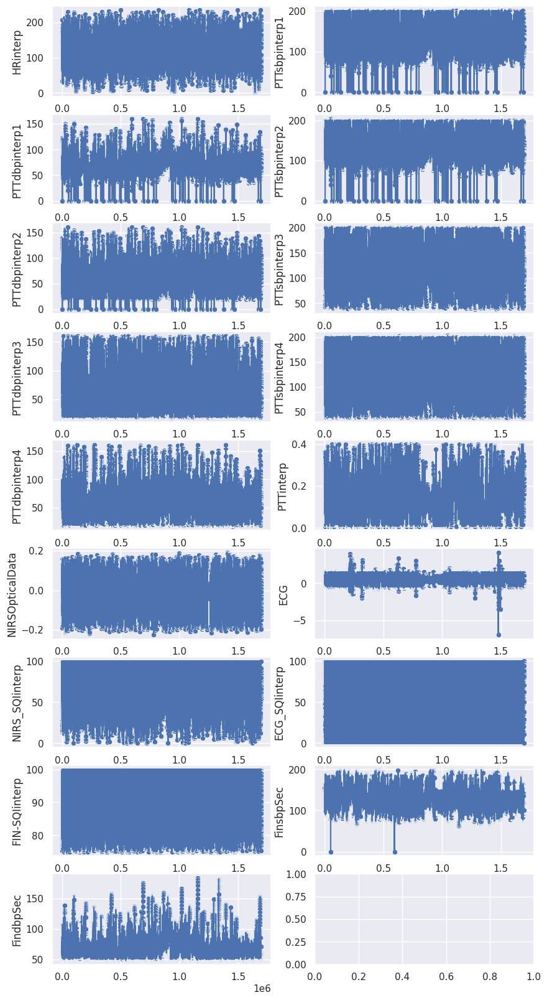

In [24]:
# Store the list of columns
columns_to_plot = df.columns
total_features_num = len(columns_to_plot)
subplot_cols = 2
subplot_rows = math.ceil(total_features_num / subplot_cols)

fig, axes = plt.subplots(subplot_rows, subplot_cols, figsize=(10, 20))

for i in range(0, total_features_num):
    row = math.floor(i/subplot_cols)
    col = i % subplot_cols
    column_name = df.columns[i]
    sns.scatterplot(ax=axes[row,col], data=df[column_name])
    sns.lineplot(ax=axes[row,col], data=df[column_name])
    
# Show the plot
# plt.tight_layout() 
plt.show()

## Boxplots of all features

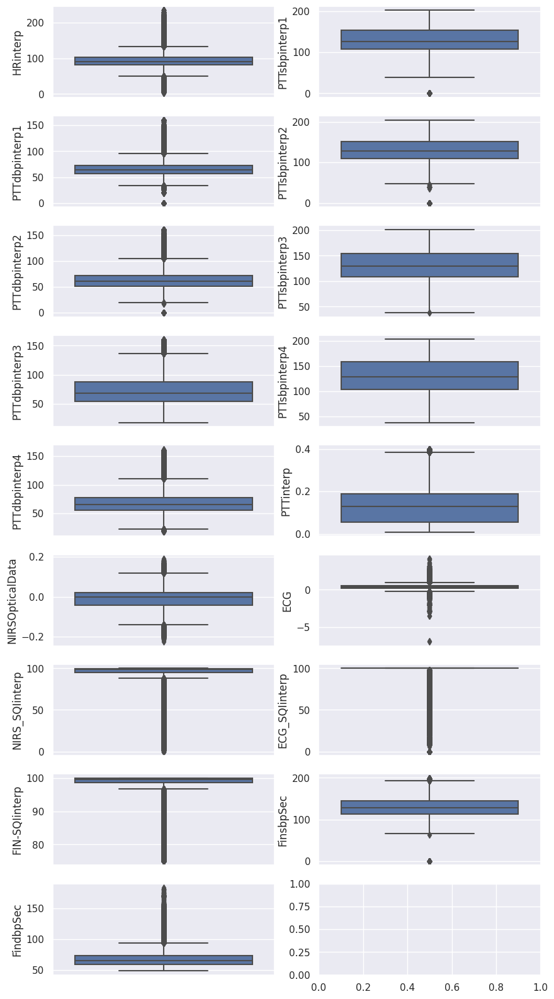

In [25]:
fig, axes = plt.subplots(subplot_rows, subplot_cols, figsize=(10, 20))

for i in range(0, total_features_num):
    row = math.floor(i/subplot_cols)
    col = i % subplot_cols
    sns.boxplot(ax=axes[row, col], y=df[df.columns[i]])
    
# Show the plot
# plt.tight_layout() 
plt.show()

## Histograms of all features

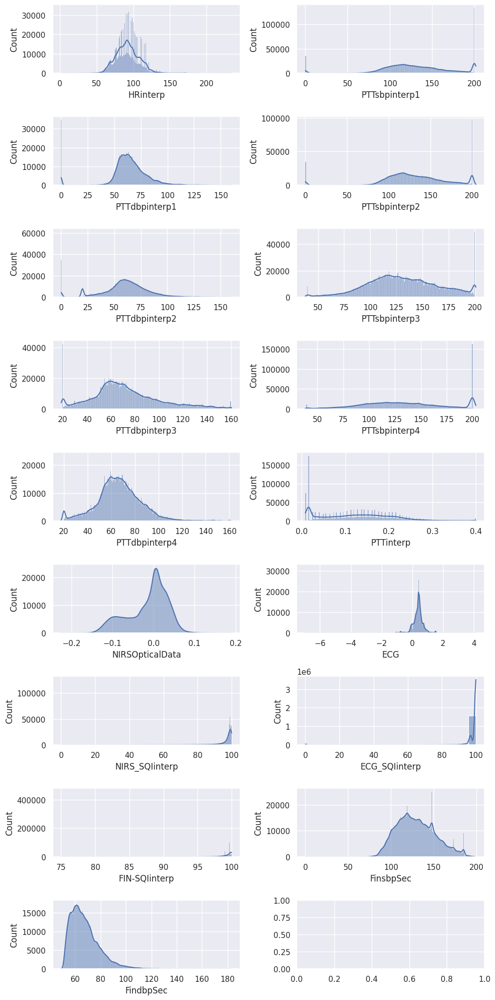

In [26]:
fig, axes = plt.subplots(subplot_rows, subplot_cols, figsize=(10, 20))

for i in range(0, total_features_num):
    row = math.floor(i/subplot_cols)
    col = i % subplot_cols
    sns.histplot(df[df.columns[i]], ax=axes[row, col], kde=True);
    
# Show the plot
plt.tight_layout() 
plt.show()

## Q-Q plots of all features

Linear models assume that the independent variables are normally distributed. Failure to meet this assumption may produce algorithms that perform poorly. We can determine whether a variable is normally distributed with histograms and Q-Q plots (short for “quantile-quantile” plots). 

A Q-Q plot,  is used to assess whether or not a set of data potentially came from some theoretical distribution.

We used it below to check whether or not (each of) our data feature follows a normal distribution.

In a Q-Q plot, the quantiles of the features are plotted against the expected quantiles of the normal distribution. If the variable is normally distributed, the dots in the Q-Q plot should fall along a 45 degree diagonal line (i.e., a straight diagonal line).

Conversely, the more the points in the plot deviate significantly from a straight diagonal line, the less likely the data (feature) follows a normal distribution.


In [27]:
# Install seaborn-qqplot library
!pip install seaborn-qqplot

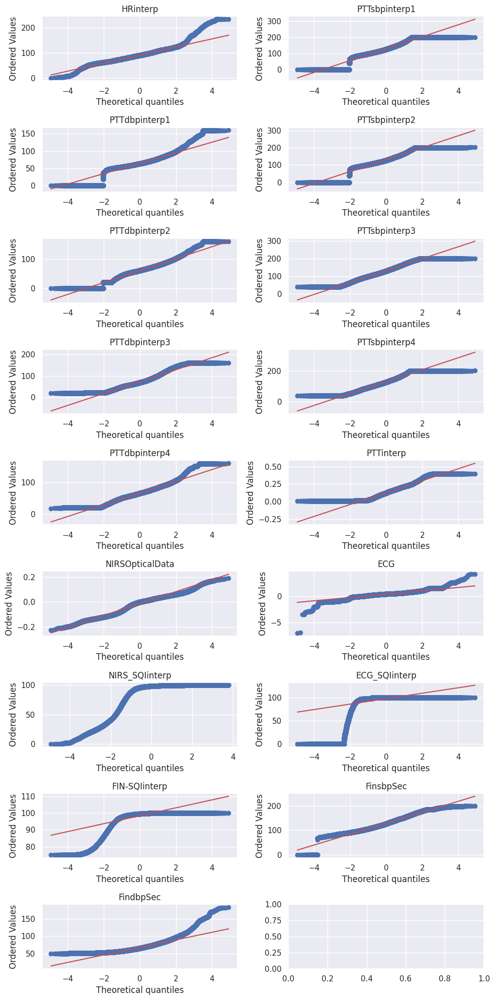

In [28]:
# QQ Plot
import scipy.stats as stats

fig, axes = plt.subplots(subplot_rows, subplot_cols, figsize=(10, 20))

for i in range(0, total_features_num):
    row = math.floor(i/subplot_cols)
    col = i % subplot_cols
    col_name = df.columns[i]
    stats.probplot(df[col_name], dist="norm", plot=axes[row, col])
    axes[row, col].set_title(col_name)
        
# Show the plot
plt.tight_layout() 
plt.show()

## Understand the distributions of 'FinsbpSec' and 'STAsbpcal' respectively using distplot and boxplot

### FinsbpSec's distribution

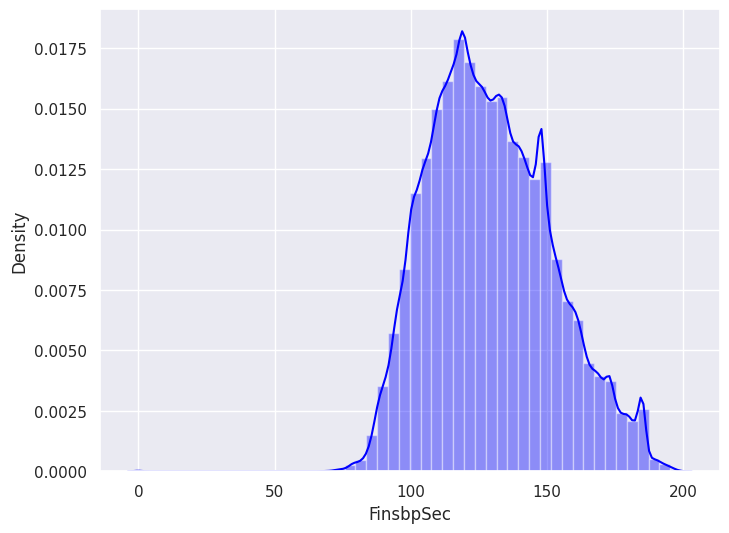

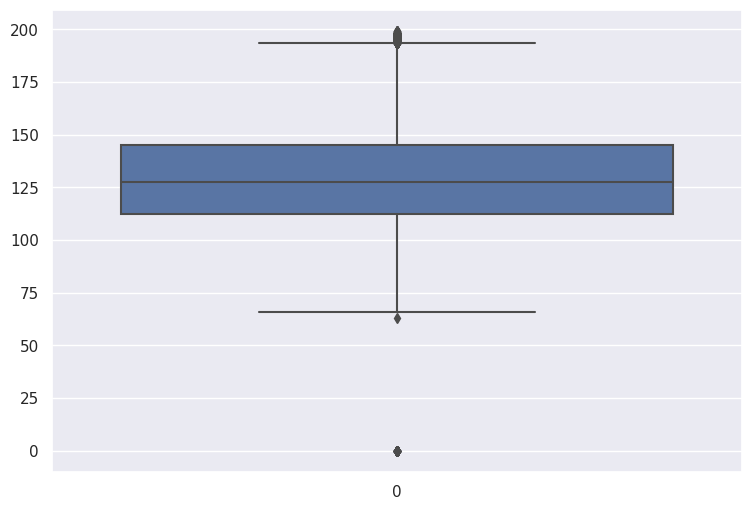

In [29]:
sns.set({'figure.figsize': (8,6)})
sns.distplot(df['FinsbpSec'],color='blue')
plt.show()
sns.set({'figure.figsize': (8.9,6)})
sns.boxplot(df['FinsbpSec'],orient='v')
plt.show()

# <a id='link5'> Bivariate analysis </a>

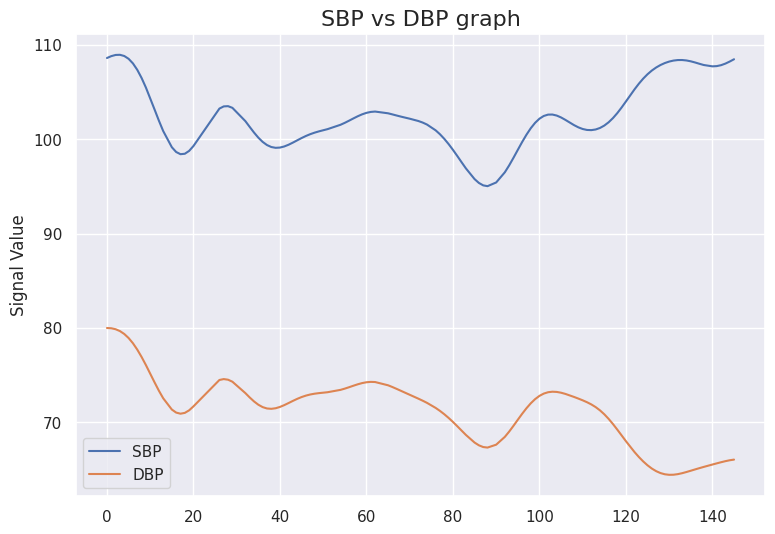

In [30]:
plt.title('SBP vs DBP graph', fontsize=16)
plt.ylabel('Signal Value')
plt.plot(df['FinsbpSec'][:125])
plt.plot(df['FindbpSec'][:125])
plt.legend(['SBP', 'DBP'])

## Pairplot for all attribute columns

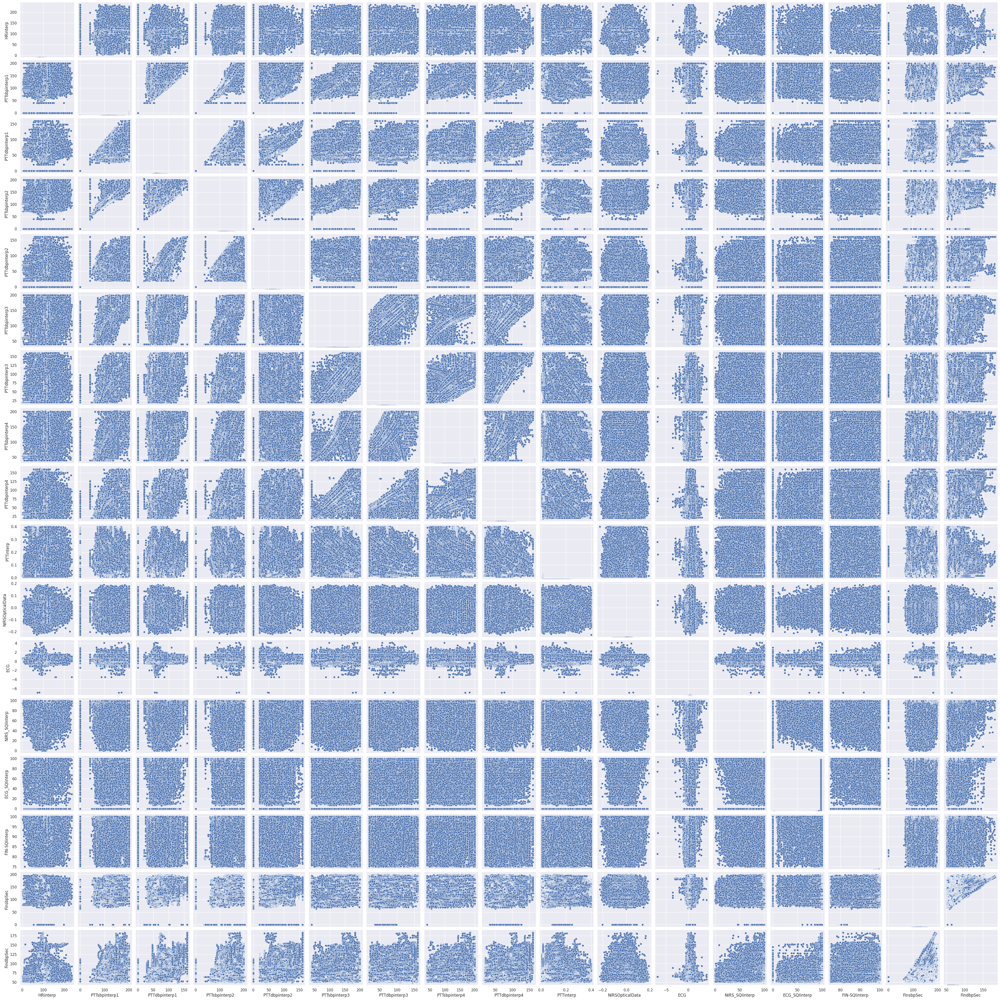

In [31]:
sns.pairplot(df)
plt.show()

## Pair-wise correlation table among all attributes

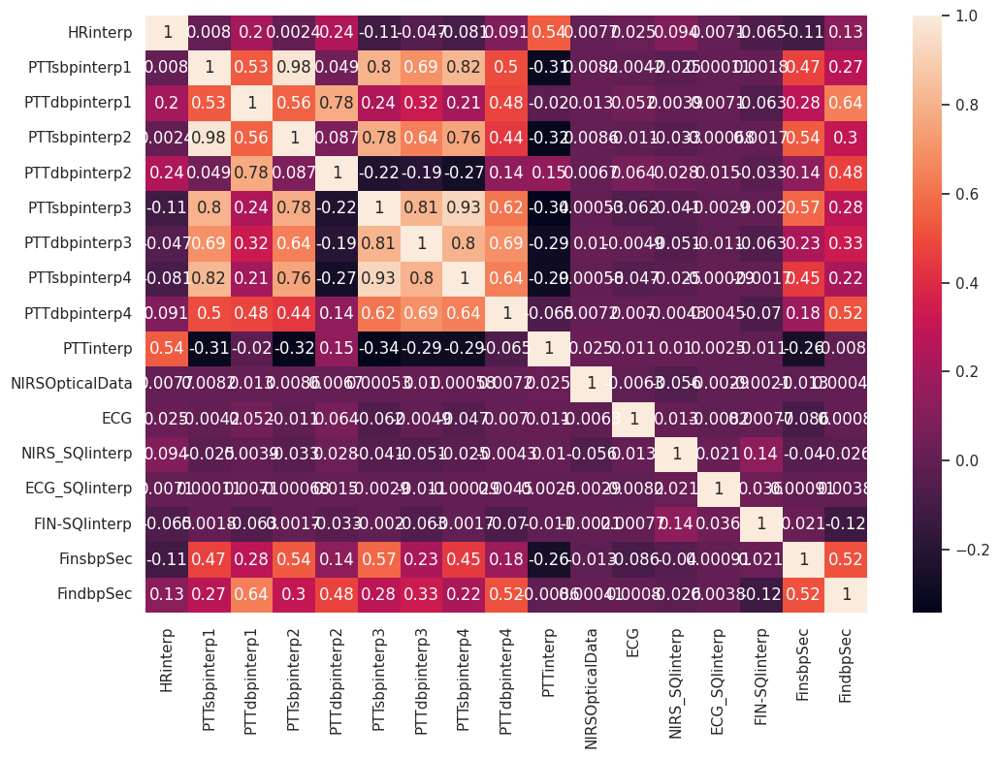

In [32]:
corr = df.corr()

plt.figure(figsize=(12,8))
sns.heatmap(corr,annot = True)
plt.show()

## Pairplots for selected SBP related columns only

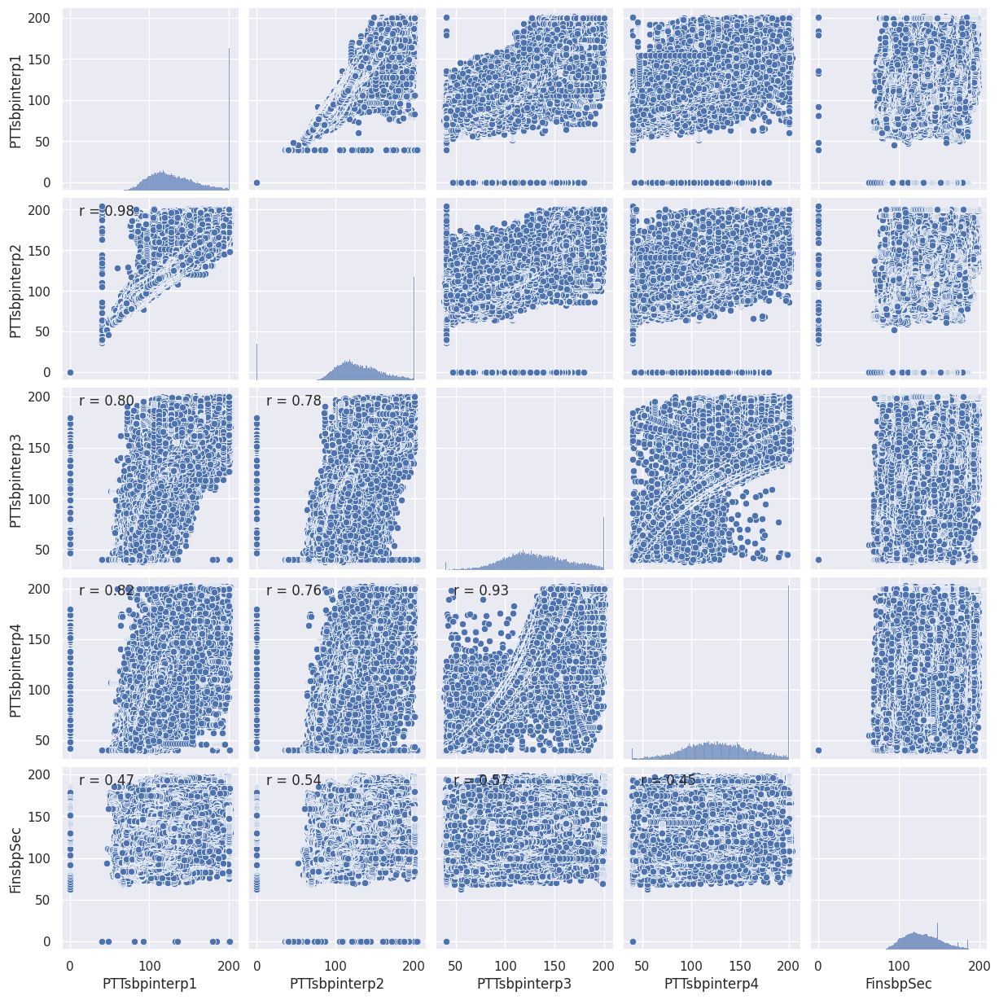

In [33]:
from scipy.stats import pearsonr
# Calculate the Pearson correlation coefficient between two variables
def corrfunc(x, y, ax=None, **kws):
    """Plot the correlation coefficient in the top left hand corner of a plot."""
    r, _ = pearsonr(x, y)
    ax = ax or plt.gca()
    ax.annotate(f'r = {r:.2f}', xy=(.1, .9), xycoords=ax.transAxes)

# Plot SBP related features pairplot

# Interested SBP related feature column names in the dataframe
interested_sbp_col_names = ['PTTsbpinterp1', 'PTTsbpinterp2',  \
                            'PTTsbpinterp3',  'PTTsbpinterp4', \
                            'FinsbpSec']
# plot SBP related features pairplots
df_sbp = df[interested_sbp_col_names]
g = sns.pairplot(df_sbp);
g.map_lower(corrfunc)
plt.show()

## Pair-wise correlation table among SBP related attributes

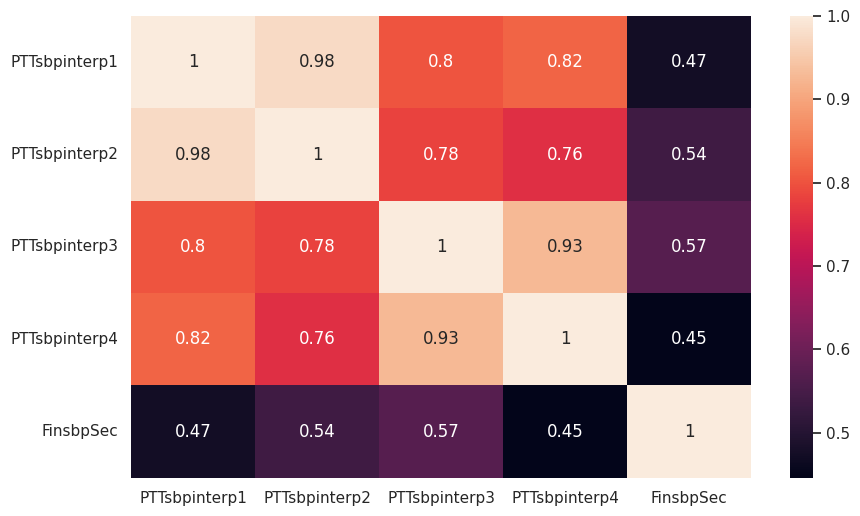

In [34]:
corr_sbp = df_sbp.corr()

plt.figure(figsize=(10,6))
sns.heatmap(corr_sbp,annot = True)
plt.show()

## Pairplots for selected DBP related columns only

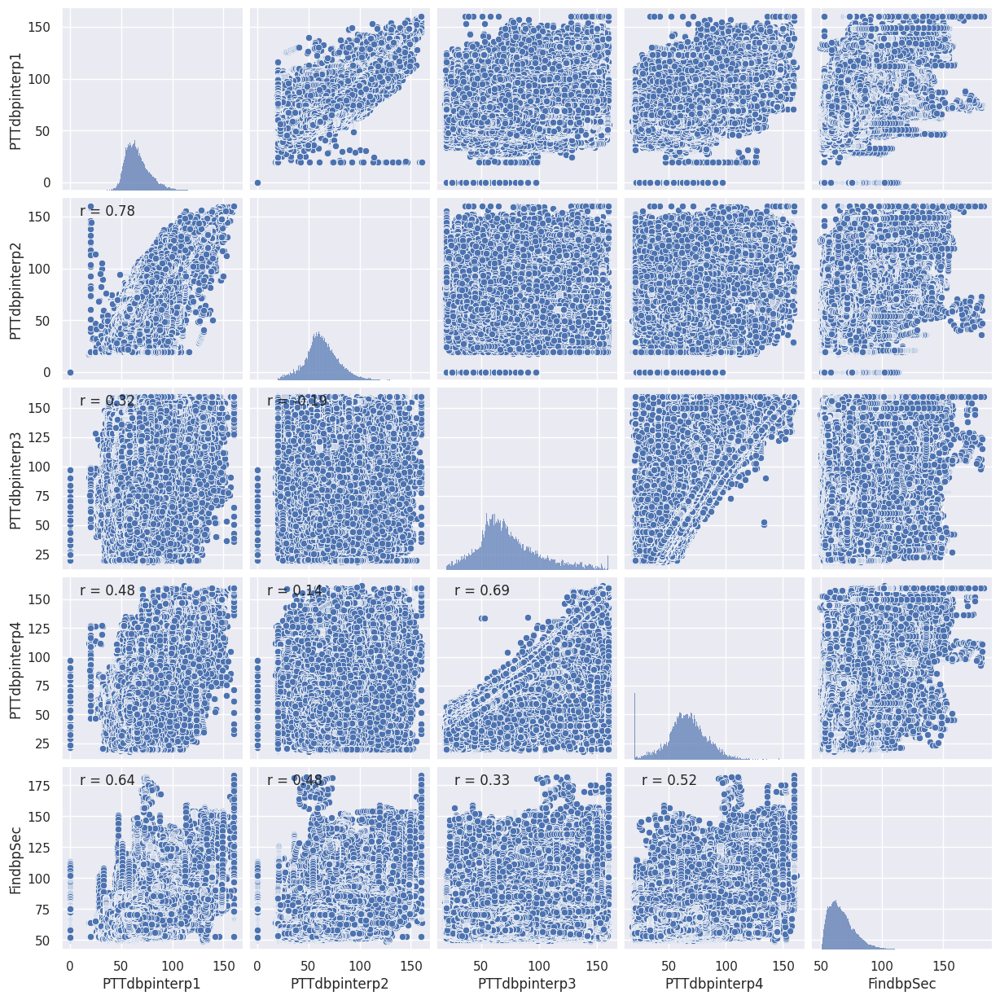

In [35]:
# Interested DBP related feature column names in the dataframe
interested_dbp_col_names = ['PTTdbpinterp1', 'PTTdbpinterp2',  \
                            'PTTdbpinterp3',  'PTTdbpinterp4', \
                            'FindbpSec']

# Plot DBP related features pairplots
df_dbp = df[interested_dbp_col_names]
g = sns.pairplot(df_dbp);
g.map_lower(corrfunc)
plt.show()

## Pair-wise correlation table among DBP related attributes

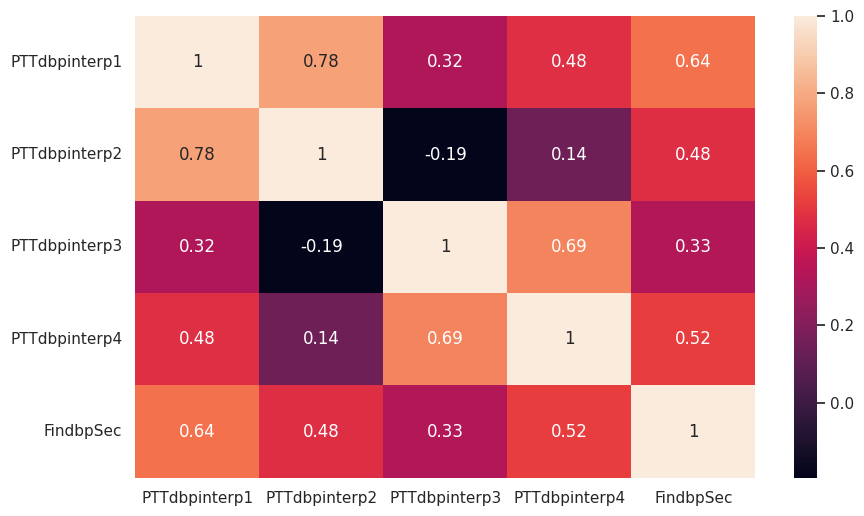

In [36]:
corr_dbp = df_dbp.corr()

plt.figure(figsize=(10,6))
sns.heatmap(corr_dbp,annot = True)
plt.show()

# <a id='link6'> Calculate PhiK (𝜙k) correlation coefficents </a>

Phik (𝜙k) is a new and practical correlation coefficient that works consistently between categorical, ordinal and interval variables, captures non-linear dependency and reverts to the Pearson correlation coefficient in case of a bivariate normal input distribution.

## Load in libraries related to PhiK correlation coefficient calculation and report

In [37]:
# Load in libraries related to PhiK correlation coefficient calculation and report
import phik
from phik.report import plot_correlation_matrix
from phik import report

## Calculate PhiK (𝜙k) correlation coefficents of SBP related features

### Define SBP related feature columns and calculate their PhiK (𝜙k) correlation matrix

In [38]:
interval_cols_sbp = ['STAsbpcal', 'PTTsbpinterp1', 'PTTsbpinterp2', 'PTTsbpinterp3', 'PTTsbpinterp4', 'FinsbpSec']
phik_overview_sbp = df_sbp.phik_matrix(interval_cols=interval_cols_sbp) # calculate the PhiK correlation coefficient matrix
phik_overview_sbp.round(2) # round the results to 2 decimals

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


,PTTsbpinterp1,PTTsbpinterp2,PTTsbpinterp3,PTTsbpinterp4,FinsbpSec
PTTsbpinterp1,1.00,0.97,0.91,0.90,0.71
PTTsbpinterp2,0.97,1.00,0.90,0.85,0.69
PTTsbpinterp3,0.91,0.90,1.00,0.95,0.50
PTTsbpinterp4,0.90,0.85,0.95,1.00,0.40
FinsbpSec,0.71,0.69,0.50,0.40,1.00


### Plot the SBP PhiK matrix results as heatmap

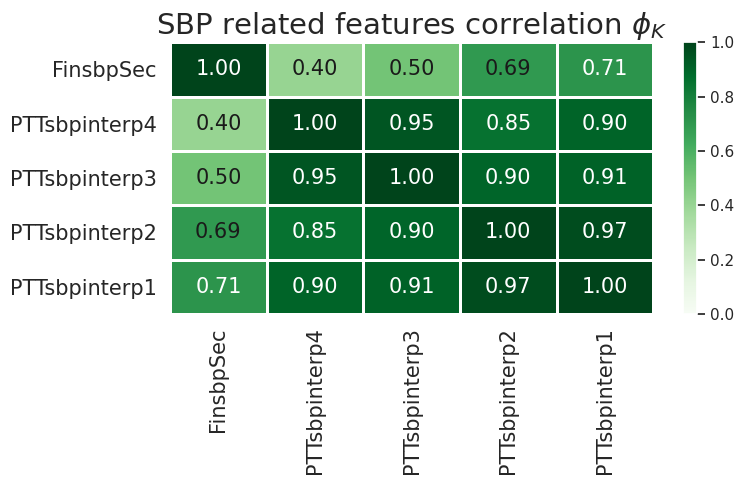

In [39]:
# Plot as heatmap for (visually) analysis convenience
plot_correlation_matrix(phik_overview_sbp.values, 
                        x_labels=phik_overview_sbp.columns, 
                        y_labels=phik_overview_sbp.index, 
                        vmin=0, vmax=1, color_map="Greens", 
                        title=r"SBP related features correlation $\phi_K$", 
                        fontsize_factor=1.5, 
                        figsize=(8, 5))
plt.tight_layout()

### Significance of the SBP related features PhiK correlations

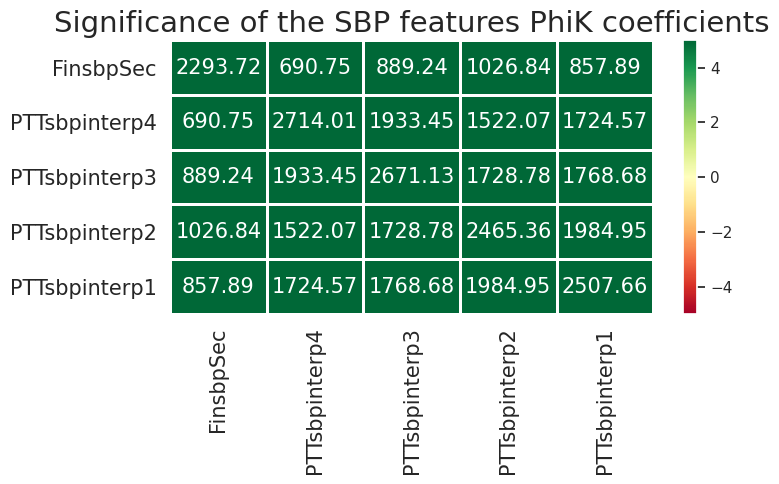

In [40]:
significance_overview_sbp = df_sbp.significance_matrix(interval_cols=interval_cols_sbp)
plot_correlation_matrix(significance_overview_sbp.fillna(0).values, 
                        x_labels=significance_overview_sbp.columns, 
                        y_labels=significance_overview_sbp.index, 
                        vmin=-5, vmax=5, title="Significance of the SBP features PhiK coefficients", 
                        usetex=False, fontsize_factor=1.5, figsize=(8, 5))
plt.tight_layout()

### Global correlation of SBP related features

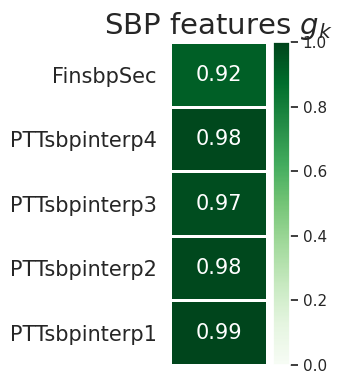

In [41]:
# The global correlation coefficient is a useful measure expressing the total correlation 
# of one variable to all other variables in the dataset. This gives us an indication 
# of how well one variable can be modeled using the other variables.
global_correlation_sbp, global_labels_sbp = df_sbp.global_phik(interval_cols=interval_cols_sbp)

plot_correlation_matrix(global_correlation_sbp, 
                        x_labels=[''], y_labels=global_labels_sbp, 
                        vmin=0, vmax=1, figsize=(3.5,4),
                        color_map="Greens", title=r"SBP features $g_k$",
                        fontsize_factor=1.5)
plt.tight_layout()

## Calculate PhiK (𝜙k) correlation coefficents of DBP related features

### Define DBP related feature columns and calculate their PhiK (𝜙k) correlation matrix

In [42]:
interval_cols_dbp = ['STAdbpcal', 'PTTdbpinterp1', 'PTTdbpinterp2', 'PTTdbpinterp3', 'PTTdbpinterp4', 'FindbpSec']
phik_overview_dbp = df_dbp.phik_matrix(interval_cols=interval_cols_dbp) # calculate the PhiK correlation coefficient matrix
phik_overview_dbp.round(2) # round the results to 2 decimals

,PTTdbpinterp1,PTTdbpinterp2,PTTdbpinterp3,PTTdbpinterp4,FindbpSec
PTTdbpinterp1,1.00,0.94,0.45,0.71,0.76
PTTdbpinterp2,0.94,1.00,0.55,0.52,0.64
PTTdbpinterp3,0.45,0.55,1.00,0.91,0.43
PTTdbpinterp4,0.71,0.52,0.91,1.00,0.62
FindbpSec,0.76,0.64,0.43,0.62,1.00


### Plot the DBP PhiK matrix results as heatmap

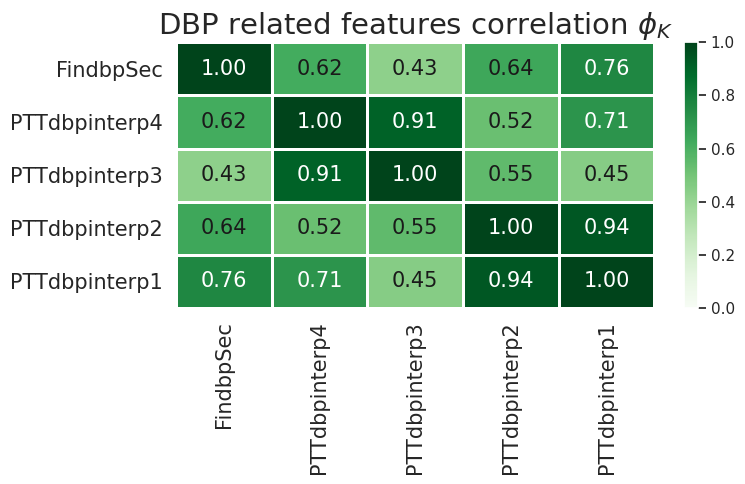

In [43]:
# Plot as heatmap for (visually) analysis convenience
plot_correlation_matrix(phik_overview_dbp.values, 
                        x_labels=phik_overview_dbp.columns, 
                        y_labels=phik_overview_dbp.index, 
                        vmin=0, vmax=1, color_map="Greens", 
                        title=r"DBP related features correlation $\phi_K$", 
                        fontsize_factor=1.5, 
                        figsize=(8, 5))
plt.tight_layout()

### Significance of the DBP features PhiK correlations

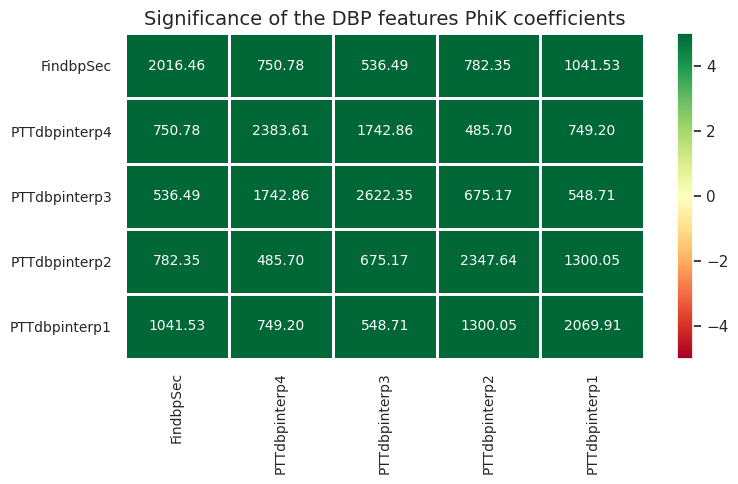

In [44]:
significance_overview_dbp = df_dbp.significance_matrix(interval_cols=interval_cols_dbp)
plot_correlation_matrix(significance_overview_dbp.fillna(0).values, 
                        x_labels=significance_overview_dbp.columns, 
                        y_labels=significance_overview_dbp.index, 
                        vmin=-5, vmax=5, title="Significance of the DBP features PhiK coefficients", 
                        usetex=False, fontsize_factor=1.0, figsize=(8, 5))
plt.tight_layout()

### Global correlation of DBP related features

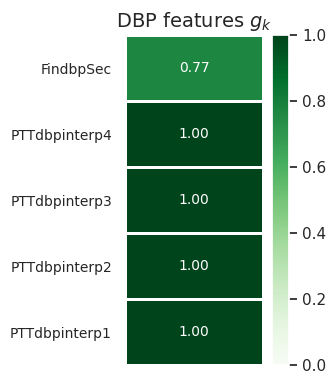

In [45]:
# The global correlation coefficient is a useful measure expressing the total correlation 
# of one variable to all other variables in the dataset. This gives us an indication 
# of how well one variable can be modeled using the other variables.
global_correlation_dbp, global_labels_dbp = df_dbp.global_phik(interval_cols=interval_cols_dbp)

plot_correlation_matrix(global_correlation_dbp, 
                        x_labels=[''], y_labels=global_labels_dbp, 
                        vmin=0, vmax=1, figsize=(3.5,4),
                        color_map="Greens", title=r"DBP features $g_k$",
                        fontsize_factor=1.0)
plt.tight_layout()

# <a id='link7'> Pandas Profiling </a>

## Pandas (EDA) profiling for all features

In [46]:
# install pandas profiling package
!pip install pandas-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 64.0 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: numpy
    Found existing installation: numpy 1.24.3
    Uninstalling numpy-1.24.3:
      Successfully uninstalled numpy-1.24.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf 23.8.0 requires cupy-cuda11x>=12.0.0, which is not installed.
cuml 23.8.0 requires cupy-cuda11x>=12.0.0, which is not installed.
dask-cudf 23.8.0 requires cupy-cuda11x>=12.0.0, which is not installed.
apache-beam 2.46.0 requires dill<0.3.2,>=0.3.1.1, but you have dill 0.3.7 which is incompatible.
apache-beam 2.46.0 requires pyarrow<10.0.0,>=3.0.0, but you have pyarrow 11.0.0 which is incompatible.
chex 0.1.84 requires numpy>=1.24.1, but you have numpy 1.23.5 which is incompatible.
cudf 23.8.0 requires pandas<1.6.0dev0,>=1.3, but you have pandas 2.0.3 which is incompatible

In [47]:
from pandas_profiling import ProfileReport

# Getting the pandas profiling report 
profile = ProfileReport(df) 
profile = df.profile_report(
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": True},
        "kendall": {"calculate": True},
        "cramers": {"calculate": False}, #cramers correlation coefficient is meant for two categorical variables
        "phi_k": {"calculate": True},
    },
)

# to view report created by pandas profile
profile 


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [48]:
profile_outDir = matfile_dir + "\\Profile_Outputs\\"

# Check whether the specified path exists or not
profile_outDir_isExist = os.path.exists(profile_outDir)
if not profile_outDir_isExist:

   # Create a new directory because it does not exist
   os.makedirs(profile_outDir)
   print("The new directory of %s is created!" % profile_outDir)

profile_outFName = "MIMIC-II_part1" + '_profile_output.html'
profile_outFullPath = os.path.join(profile_outDir, profile_outFName)

# to save report obtained via pandas profiling
profile.to_file(output_file = profile_outFullPath)

print("Profile output written to %s:" % profile_outFullPath)

The new directory of /kaggle/working\sopData\\Profile_Outputs\ is created!


Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profile output written to /kaggle/working\sopData\\Profile_Outputs\/MIMIC-II_part1_profile_output.html:


## Pandas (EDA) profiling for SBP related features only

In [49]:
# Get sbp related columns/features to a DataFrame
interested_sbp_col_names = ['PTTsbpinterp1', 'PTTsbpinterp2',  \
                            'PTTsbpinterp3',  'PTTsbpinterp4', \
                            'FinsbpSec']
df_sbp = df[interested_sbp_col_names]

In [50]:
#Getting the pandas profiling report 
profile_sbp = ProfileReport(df_sbp) 
profile_sbp = df_sbp.profile_report(
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": True},
        "kendall": {"calculate": True},
        "cramers": {"calculate": False}, #cramers correlation coefficient is meant for two categorical variables
        "phi_k": {"calculate": True},
    },
)

# to view report created by pandas profile
profile_sbp 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [51]:
# profile_sbp_outDir = matfile_dir + "\\Profile_Outputs\\\\SBP_Profile_Outputs"

# # Check whether the specified path exists or not
# profile_sbp_outDir_isExist = os.path.exists(profile_sbp_outDir)
# if not profile_sbp_outDir_isExist:

#    # Create a new directory because it does not exist
#    os.makedirs(profile_sbp_outDir)
#    print("The new directory of %s is created!" % profile_sbp_outDir)

# profile_sbp_outFName = matfile_fname_woExt + '_sbp_profile_output.html'
# profile_sbp_outFullPath = os.path.join(profile_sbp_outDir, profile_sbp_outFName)

# # Save report obtained via pandas profiling
# profile_sbp.to_file(output_file = profile_sbp_outFullPath)

## Pandas (EDA) profiling for DBP related features only¶

In [52]:
# Get sbp related columns/features to a DataFrame
interested_dbp_col_names = ['PTTdbpinterp1', 'PTTdbpinterp2',  \
                            'PTTdbpinterp3',  'PTTdbpinterp4', \
                            'FindbpSec']
df_dbp = df[interested_dbp_col_names]

In [53]:
#Getting the pandas profiling report 
profile_dbp = ProfileReport(df_dbp) 
profile_dbp = df_dbp.profile_report(
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": True},
        "kendall": {"calculate": True},
        "cramers": {"calculate": False}, #cramers correlation coefficient is meant for two categorical variables
        "phi_k": {"calculate": True},
    },
)

# to view report created by pandas profile
profile_dbp 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [54]:
# profile_dbp_outDir = matfile_dir + "\\Profile_Outputs\\DBP_Profile_Outputs"

# # Check whether the specified path exists or not
# profile_dbp_outDir_isExist = os.path.exists(profile_dbp_outDir)
# if not profile_dbp_outDir_isExist:

#    # Create a new directory because it does not exist
#    os.makedirs(profile_dbp_outDir)
#    print("The new directory of %s is created!" % profile_dbp_outDir)

# profile_dbp_outFName = matfile_fname_woExt + '_dbp_profile_output.html'
# profile_dbp_outFullPath = os.path.join(profile_dbp_outDir, profile_dbp_outFName)

# # to save report obtained via pandas profiling
# profile_dbp.to_file(output_file = profile_dbp_outFullPath)

# print("Profile output written to %s:" % profile_dbp_outFullPath)

# <a id='link8'> Export/Save This Notebook to a Html File </a>

In [55]:
# import ipynbname
# nb_fname_woExt = ipynbname.name() 
# print(f"{nb_fname_woExt=}")

# nb_fname = nb_fname_woExt + '.ipynb'
# print(f"{nb_fname=}")

# # Export/save this notebook to a .html file. 
# out_html_fname = matfile_fname_woExt + '.html' # the .html file name has the same base filename (without extension) 
#                                                # as that of the input .mat file

    
# out_html_dir = matfile_dir + "\\Notebook_Html_Outputs\\"
# print(f"{out_html_dir=}")

# # Check whether the specified path exists or not
# out_html_dir_isExist = os.path.exists(out_html_dir)

# if not out_html_dir_isExist:

#    # Create a new directory because it does not exist
#    os.makedirs(out_html_dir)
#    print("The new directory of %s is created!" % out_html_dir)
      
# # Export/save this notebook (including cells running results) to the output .html file
# !jupyter nbconvert {nb_fname} --to html --output {out_html_fname} --output-dir {out_html_dir}

# out_html_fullPath = os.path.join(out_html_dir, out_html_fname) # output .html full path

# print("This dataset's notebook exported to %s:" % out_html_fullPath)
